# 2D FitzHugh-Nagumo Equation: Spirals and Turing Patterns

This notebook implements and compares two methods for solving the 2D FitzHugh-Nagumo equation using the Finite Difference Method (FDM).

The FitzHugh-Nagumo model is a system of reaction-diffusion equations describing neuronal excitation.

$$ 
\begin{aligned}
\frac{\partial u}{\partial t} &= D_u \Delta u + \lambda u - u^3 - \kappa - \sigma v \\
\frac{\partial v}{\partial t} &= \frac{1}{\tau} (D_v \Delta v + u - v)
\end{aligned}
$$

**Domain:** $(x,y) \in [-1, 1] \times [-1, 1]$, $t \in [0, T]$

**Boundary Conditions:** Periodic/Neumann on the spatial domain.

In [229]:
import numpy as np
import matplotlib.pyplot as plt

# Set seeds for reproducibility
np.random.seed(89757)

## 1. Problem Setup and Parameters

In [230]:
# Parameters for FitzHugh-Nagumo

# --- Parameters for rotating spiral patterns ---
Du = 1e-3  # Diffusion coeff for u
Dv = 0.0   # Diffusion coeff for v (often 0)
lam = 1.0  
kappa = 0.0
sigma = 1.0
tau = 12.5

# --- Parameters for sustained Turing patterns ---
# Key condition: Inhibitor (v) must diffuse much faster than the activator (u).
# Du = 1e-3   # Diffusion coeff for u (activator)
# Dv = 5e-2   # Diffusion coeff for v (inhibitor) -> Must be >> Du
# lam = 1.0   # lambda
# kappa = 0.0 # A small negative kappa can help select spots
# sigma = 1.0  # Controls the strength of the inhibitor feedback
# tau = 10.0   # Time scale separation

# --- Boundary Condition Selection ---
# Choose 'periodic' or 'neumann'
boundary_condition_type = 'neumann' 

# Domain
x_min, x_max = -2.0, 2.0
y_min, y_max = -2.0, 2.0
t_min, t_max = 0.0, 500.0

# --- Initial Condition Functions ---
def initial_condition_gaussian_random(x, y):
    """ IC with random Gaussian noise. """
    u0 = np.random.randn(*x.shape) * 0.1
    v0 = np.random.randn(*x.shape) * 0.1
    return u0, v0

def initial_condition_plane_wave(x, y):
    """
    IC: Generates a clean spiral wave by combining a broken plane wave and a circular phase-shifted region.
    """
    u0 = np.zeros_like(x)
    v0 = np.zeros_like(x)

    # Parameters for spiral nucleation
    x0, y0 = -0.2 * np.pi, 0.1 * np.pi # Center of spiral
    r = np.sqrt((x - x0)**2 + (y - y0)**2)
    theta = np.arctan2(y - y0, x - x0)

    # Plane wave: left half of the domain (y < 0)
    # mask_plane = y < 0.0
    # u0[mask_plane] = np.tanh(-10 * (x[mask_plane] + 0.5))

    # Circular region: phase shift to break the wave and nucleate spiral
    mask_circle = r < 5
    u0[mask_circle] = np.tanh(1 * (10 - 0.1 * r[mask_circle])) * np.cos(theta[mask_circle])

    # Optionally, add a small random noise for numerical stability
    u0 += 0.01 * np.random.randn(*x.shape)
    v0 += 0.01 * np.random.randn(*x.shape)

    return u0, v0

def initial_condition_single_centered_spiral(x, y):
    """
    IC: Generates a single spiral wave centered at (0,0).
    """
    r = np.sqrt(x**2 + y**2)
    theta = np.arctan2(y, x)
    
    # Wavenumber of the spiral
    k = 2 * np.pi
    
    u0 = np.tanh(r) * np.cos(theta - k * r)
    v0 = np.tanh(r) * np.sin(theta - k * r)
    
    return u0, v0

def initial_condition_half_plane(x, y):
    """ IC: Half-plane excitation. """
    u0 = np.where(y + x < 0, 1.0, -1.0)
    v0 = np.zeros_like(u0)

    u0 += 0.01 * np.random.randn(*x.shape)
    v0 += 0.01 * np.random.randn(*x.shape)

    return u0, v0

# Set which initial condition to use for the simulation
# Options: initial_condition_gaussian_random, initial_condition_plane_wave, initial_condition_single_centered_spiral, initial_condition_half_plane
initial_condition = initial_condition_single_centered_spiral

## 2. Finite Difference Solver

Running FDM Solver with neumann BC, saving 500 snapshots...


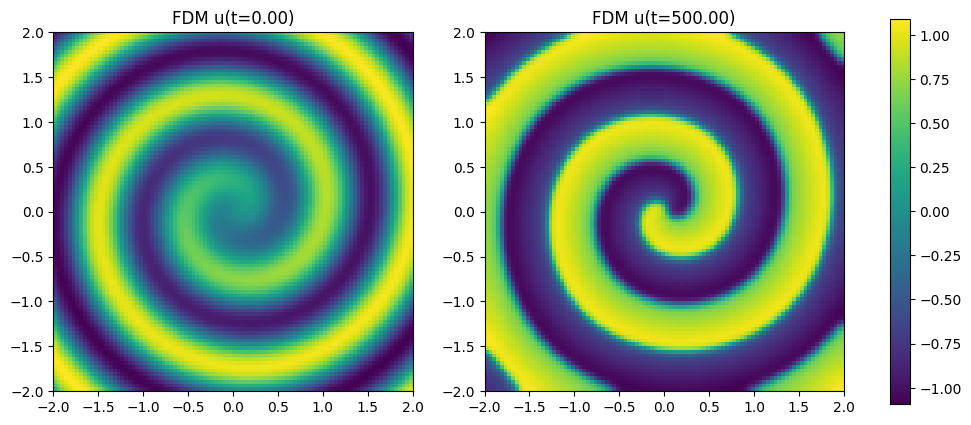

In [231]:
def laplacian_2d_periodic(u, dx, dy):
    # 5-point stencil with periodic boundaries
    u_top = np.roll(u, 1, axis=0)
    u_bottom = np.roll(u, -1, axis=0)
    u_left = np.roll(u, 1, axis=1)
    u_right = np.roll(u, -1, axis=1)
    
    d2u_dx2 = (u_left - 2*u + u_right) / dx**2
    d2u_dy2 = (u_top - 2*u + u_bottom) / dy**2
    
    return d2u_dx2 + d2u_dy2

def laplacian_2d_neumann(u, dx, dy):
    # Pad with ghost cells to enforce Neumann BC (du/dn = 0)
    # The value of the ghost cell is the same as its neighbor in the domain.
    u_padded = np.pad(u, 1, mode='edge')
    
    # Standard 5-point stencil on the padded grid
    d2u_dx2 = (u_padded[1:-1, 2:] - 2*u_padded[1:-1, 1:-1] + u_padded[1:-1, :-2]) / dx**2
    d2u_dy2 = (u_padded[2:, 1:-1] - 2*u_padded[1:-1, 1:-1] + u_padded[:-2, 1:-1]) / dy**2
    
    return d2u_dx2 + d2u_dy2

def solve_fdm(Nx=100, Ny=100, Nt=1000, bc_type='periodic', num_snapshots=20):
    x = np.linspace(x_min, x_max, Nx, endpoint=False)
    y = np.linspace(y_min, y_max, Ny, endpoint=False)
    X, Y = np.meshgrid(x, y)
    
    dx = (x_max - x_min) / Nx
    dy = (y_max - y_min) / Ny
    dt = (t_max - t_min) / Nt

    # Stability check for Euler
    if Du * dt / dx**2 > 0.25:
        print("Warning: Time step might be unstable for explicit Euler!")
    
    u, v = initial_condition(X, Y)
    
    # Select Laplacian function based on BC type
    laplacian_func = laplacian_2d_periodic if bc_type == 'periodic' else laplacian_2d_neumann

    # Storage for comparison
    u_hist = [u.copy()]
    v_hist = [v.copy()]
    t_hist = [0.0]
    
    # Determine how often to save a snapshot
    save_every_n_steps = Nt // num_snapshots
    if save_every_n_steps == 0:
        save_every_n_steps = 1 # Avoid division by zero and save every step

    print(f"Running FDM Solver with {bc_type} BC, saving {num_snapshots} snapshots...")
    for n in range(Nt):
        lap_u = laplacian_func(u, dx, dy)
        lap_v = laplacian_func(v, dx, dy)
        
        # Euler step
        du = (Du * lap_u + lam * u - u**3 - kappa - sigma * v) * dt
        dv = (1/tau) * (Dv * lap_v + u - v) * dt
        
        u += du
        v += dv
        
        # Save snapshot at specified intervals
        if (n + 1) % save_every_n_steps == 0:
            u_hist.append(u.copy())
            v_hist.append(v.copy())
            t_hist.append((n + 1) * dt)
            
    return np.array(t_hist), np.array(u_hist), np.array(v_hist), X, Y

t_fdm, u_fdm, v_fdm, X_fdm, Y_fdm = solve_fdm(Nx=96, Ny=96, Nt=10000, 
                                             bc_type=boundary_condition_type, 
                                             num_snapshots=500)

# Plot Initial and Final State from FDM
fig, ax = plt.subplots(1, 2, figsize=(12, 5))
ax[0].imshow(u_fdm[0], extent=[x_min, x_max, y_min, y_max], origin='lower')
ax[0].set_title(f'FDM u(t={t_fdm[0]:.2f})')
ax[1].imshow(u_fdm[-1], extent=[x_min, x_max, y_min, y_max], origin='lower')
ax[1].set_title(f'FDM u(t={t_fdm[-1]:.2f})')
plt.colorbar(ax[1].images[0], ax=ax, orientation='vertical', fraction=.1)
plt.show()

## 2.5. Animate FDM Solution Over Time

In [232]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Data for the animation from the FDM solver
u_movie = u_fdm
t_movie = t_fdm

fig, ax = plt.subplots(figsize=(8, 6))
im = ax.imshow(u_movie[0], extent=[x_min, x_max, y_min, y_max], origin='lower', animated=True)
plt.colorbar(im)
ax.set_title(f'FDM Solution, t = {t_movie[0]:.2f}')

def update(frame):
    """Update function for the animation."""
    im.set_array(u_movie[frame])
    ax.set_title(f'FDM Solution, t = {t_movie[frame]:.2f}')
    return im,

# Create the animation
# The 'interval' parameter controls the delay between frames in milliseconds.
# A higher value will make the animation slower and smoother.
anim = FuncAnimation(fig, update, frames=len(u_movie), blit=True, interval=50)

# To prevent the static plot from displaying, we close the figure.
plt.close(fig)

# Display the animation
HTML(anim.to_jshtml())
# HTML(anim.to_html5_video())

Animation size has reached 20981714 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
